In [1]:
import argparse
import os, sys, time
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torchvision
import torchvision.transforms as transforms
import torchvision.utils as vutils

from tools.dataset import CIFAR10
from torch.utils.data import DataLoader
from tools.net import Generator, Discriminator

In [2]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(device)

cuda


### Data Loading and Preprocessing

In [13]:
class Config:
    lr = 0.0002
    nz = 100 # noise dimension
    image_size = 64
    nc = 3 # chanel of img
    ngf = 64 # generate channel
    ndf = 64 # discriminative channel
    beta = (0.5, 0.999)
    batch_size = 128
    max_epoch = 10
    workers = 4
    gpu = True
    checkpoint_path = "./saved_model"

opt=Config()

In [4]:
transform=transforms.Compose([
    transforms.Resize(64),
    transforms.ToTensor(),
    transforms.Normalize([0.5]*3,[0.5]*3)
])

In [5]:
DATA_ROOT = "./data"
TRAIN_BATCH_SIZE = opt.batch_size
VAL_BATCH_SIZE = 100

# construct datasets
train_set = CIFAR10(
    root=DATA_ROOT,
    mode='train',
    download=True,
    transform=transform
)
val_set = CIFAR10(
    root=DATA_ROOT,
    mode='val',
    download=True,
    transform=transform    
)

# construct dataloaders
train_loader = DataLoader(
    train_set,
    batch_size=TRAIN_BATCH_SIZE, 
    shuffle=True,  
    num_workers=opt.workers
)
val_loader = DataLoader(
    val_set,
    batch_size=VAL_BATCH_SIZE,
    shuffle=True,   
    num_workers=opt.workers
)

Using downloaded and verified file: ./data/cifar10_trainval_F22.zip
Extracting ./data/cifar10_trainval_F22.zip to ./data
Files already downloaded and verified
Using downloaded and verified file: ./data/cifar10_trainval_F22.zip
Extracting ./data/cifar10_trainval_F22.zip to ./data
Files already downloaded and verified


### Model

0.0003950894 0.99971926
torch.Size([64, 64, 3])


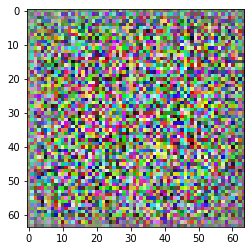

In [6]:
generator = Generator()
dummyInput = torch.randn(1,100,1,1)
testOut = generator.forward(dummyInput)
testOut = (testOut+1)/2
print(np.min(testOut.detach().numpy()), np.max(testOut.detach().numpy()))
testOut = np.squeeze(testOut.permute(2,3,1,0))
print(testOut.shape)
plt.imshow(testOut.detach().numpy())

In [7]:
discriminator = Discriminator()
dtestOut = np.squeeze(discriminator.forward(generator.forward(dummyInput)))
print(dtestOut.shape, dtestOut)

torch.Size([]) tensor(0.4550, grad_fn=<SqueezeBackward0>)


In [8]:
def initialize_weights(model):
    if model.__class__.__name__.find('Conv') != -1:
        nn.init.normal_(model.weight.data, 0.0, 0.02)
    elif model.__class__.__name__.find('BatchNorm') != -1:
        nn.init.normal_(model.weight.data, 1.0, 0.02)

In [9]:
generator.apply(initialize_weights)
discriminator.apply(initialize_weights)

Discriminator(
  (cv1): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (ac1): LeakyReLU(negative_slope=0.2, inplace=True)
  (cv2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (ac2): LeakyReLU(negative_slope=0.2, inplace=True)
  (cv3): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (ac3): LeakyReLU(negative_slope=0.2, inplace=True)
  (cv4): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (bn4): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (ac4): LeakyReLU(negative_slope=0.2, inplace=True)
  (cv5): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bia

### Training

In [10]:
criterion = nn.BCELoss()
test_input = torch.randn(64, 100, 1, 1, device=device)

test_input.to(device)
generator.to(device)
discriminator.to(device)

optimizerG = optim.Adam(generator.parameters(), lr=opt.lr, betas=opt.beta)
optimizerD = optim.Adam(discriminator.parameters(), lr=opt.lr, betas=opt.beta)

In [11]:
def calc_loss_acc(generator, discriminator, real_data, noise, criterion, VERBOSE=True):
    real_labels = torch.full((len(real_data),), 1., dtype=torch.float, device=device)
    fake_labels = torch.full((len(noise),), 0., dtype=torch.float, device=device)
    
    # Network outputs
    fake_data = generator(noise)
    d_real_out = discriminator(real_data)
    d_fake_out = discriminator(fake_data)
    
    # Accuracies
    d_real_pred = (torch.sigmoid(d_real_out) >= 0.5).sum().item()
    d_fake_pred = (torch.sigmoid(d_fake_out) < 0.5).sum().item()
    d_acc = (d_real_pred + d_fake_pred) / (len(d_real_out) + len(d_fake_out))
    g_acc = (len(d_fake_out) - d_fake_pred) / len(d_fake_out)
    D_acc.append(d_acc), G_acc.append(g_acc)
    
    # Losses
    d_loss = criterion(d_fake_out.view(-1), fake_labels) + criterion(d_real_out.view(-1), real_labels)
    g_loss = d_real_out.mean().item()
    D_losses.append(d_loss.item()), G_losses.append(g_loss)
    
    if VERBOSE:
        print("- [Test]: D loss: %.4f | G loss: %.4f | D acc: %.3f | G acc: %.3f" % (d_loss, g_loss, d_acc, g_acc))

In [12]:
img_list = []
G_losses = []
D_losses = []
G_acc = []
D_acc = []
iters = 0

In [14]:
CHECKPOINT_FOLDER = opt.checkpoint_path
real_labels = torch.full((TRAIN_BATCH_SIZE,), 1., dtype=torch.float, device=device)
fake_labels = torch.full((TRAIN_BATCH_SIZE,), 0., dtype=torch.float, device=device)

print("===> Training starts")
for epoch in range(opt.max_epoch):
    
    print("Epoch %d:" %epoch)
    generator.train()
    discriminator.train()
    
    for batch_idx, (inputs, labels) in enumerate(train_loader):
        
        inputs = inputs.to(device)
        labels = labels.to(device)
        
        #--------------------------
        # Update Discriminator
        #--------------------------
        
        discriminator.zero_grad()
        
        ## Train with generator/fake inputs
        
        g_in = torch.randn(TRAIN_BATCH_SIZE, 100, 1, 1, device=device)
        g_out = generator(g_in)
        d_out = discriminator(g_out.detach()).view(-1)
        errD_fake = criterion(d_out, fake_labels)
        errD_fake.backward()
        D_G_z1 = d_out.mean().item()
        fake_pred = ((d_out <= 0.5).float() == 1).sum().item()
        
        ## Train with the real data
        
        d_out = discriminator(inputs).view(-1)
        errD_real = criterion(d_out, real_labels[:len(inputs)])
        errD_real.backward()
        D_x = d_out.mean().item()
        real_pred = ((d_out > 0.5).float() == 1).sum().item()

        # Compute error of discriminator
        errD = errD_real + errD_fake
        optimizerD.step()

        #--------------------------
        # Update Generator
        #--------------------------
        
        generator.zero_grad()
        d_out = discriminator(g_out).view(-1)
        errG = criterion(d_out, real_labels)
        errG.backward()
        D_G_z2 = d_out.mean().item()
        optimizerG.step()

        # Output training stats
        if batch_idx % 150 == 0:
            print('[%d/%d]\tLoss_D: %.4f | Loss_G: %.4f | D(x): %.4f | D(G(z)): %.4f / %.4f'
                  % (batch_idx, len(train_loader), errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Check the performance of the generator and append losses
        if (iters % 500 == 0) or ((epoch == opt.max_epoch-1) and (batch_idx == len(train_loader)-1)):
            G_losses.append(errG.item())
            D_losses.append(errD.item())
            with torch.no_grad():
                fake_img = generator(test_input).detach().cpu()
            img_list.append(vutils.make_grid(fake_img, padding=2, normalize=True))

        iters += 1
        
    # Calculate losses, accuracies, and display generator's output
    calc_loss_acc(generator, discriminator, next(iter(val_loader))[0].cuda(), test_input, criterion)  
        
    # Save model
    if epoch % 5 == 0 and epoch != 0:
        if not os.path.exists(opt.checkpoint_path):
            os.makedirs(opt.checkpoint_path)
        print("Saving ...")
        stateG = {'state_dict': generator.state_dict(),
                'epoch': epoch}
        stateD = {'state_dict': discriminator.state_dict(),
                'epoch': epoch}
        torch.save(stateG, "./saved_model/GAN_generator.pth")
        torch.save(stateD, "./saved_model/GAN_discriminator.pth")

===> Training starts
Epoch 0:
[0/352]	Loss_D: 1.5512 | Loss_G: 4.8382 | D(x): 0.5184 | D(G(z)): 0.4754 / 0.0119
[150/352]	Loss_D: 0.3437 | Loss_G: 5.9103 | D(x): 0.7943 | D(G(z)): 0.0350 / 0.0138
[300/352]	Loss_D: 0.3619 | Loss_G: 5.7120 | D(x): 0.8981 | D(G(z)): 0.2087 / 0.0047
- [Test]: D loss: 1.6428 | G loss: 0.3251 | D acc: 0.610 | G acc: 1.000
Epoch 1:
[0/352]	Loss_D: 1.2281 | Loss_G: 1.1929 | D(x): 0.4408 | D(G(z)): 0.0425 / 0.4001
[150/352]	Loss_D: 2.4804 | Loss_G: 1.8425 | D(x): 0.1900 | D(G(z)): 0.0267 / 0.2274
[300/352]	Loss_D: 0.5061 | Loss_G: 3.8322 | D(x): 0.8360 | D(G(z)): 0.2438 / 0.0342
- [Test]: D loss: 0.3166 | G loss: 0.8968 | D acc: 0.610 | G acc: 1.000
Epoch 2:
[0/352]	Loss_D: 0.3243 | Loss_G: 3.7135 | D(x): 0.8957 | D(G(z)): 0.1592 / 0.0439
[150/352]	Loss_D: 0.4668 | Loss_G: 4.4197 | D(x): 0.8787 | D(G(z)): 0.2539 / 0.0214
[300/352]	Loss_D: 0.4719 | Loss_G: 3.6493 | D(x): 0.8872 | D(G(z)): 0.2603 / 0.0392
- [Test]: D loss: 0.5756 | G loss: 0.7406 | D acc: 0.610 |

### Evaluation

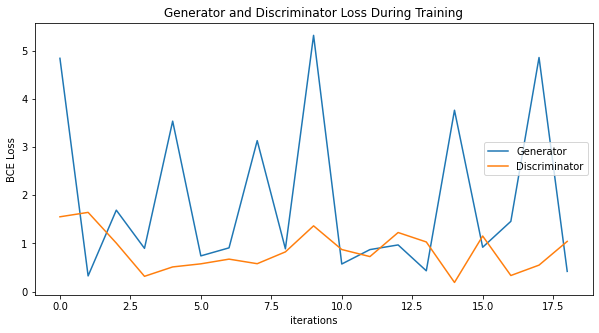

In [15]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="Generator")
plt.plot(D_losses,label="Discriminator")
plt.xlabel("iterations")
plt.ylabel("BCE Loss")
plt.legend()
plt.show()

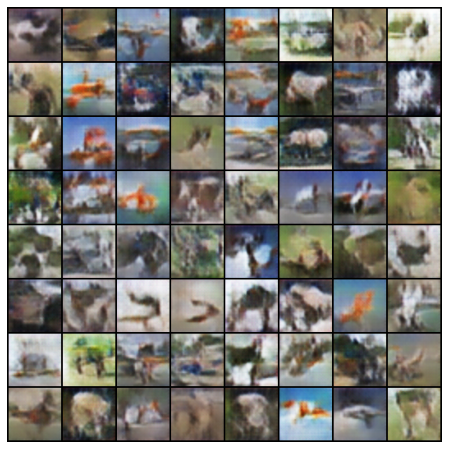

In [16]:
import matplotlib.animation as animation
from IPython.display import HTML

fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

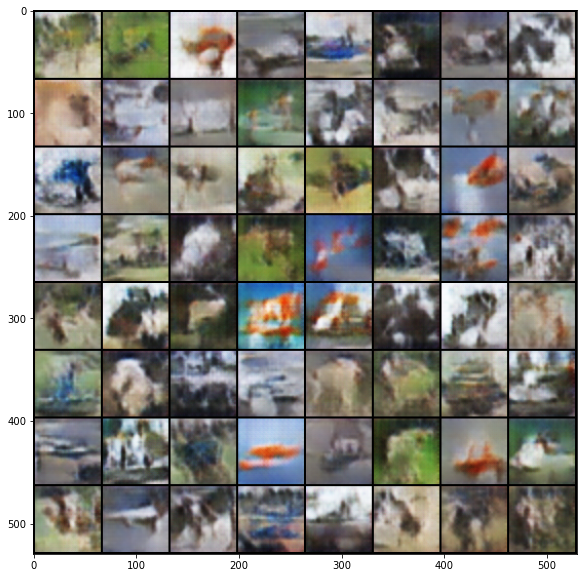

In [17]:
noise = torch.randn(64,opt.nz,1,1).cuda()
noise = torch.autograd.Variable(noise)
fake_u = generator(noise)
imgs = torchvision.utils.make_grid(fake_u.data*0.5+0.5).cpu()
plt.figure(figsize=(10,10))
plt.imshow(imgs.permute(1,2,0).numpy())
plt.show()

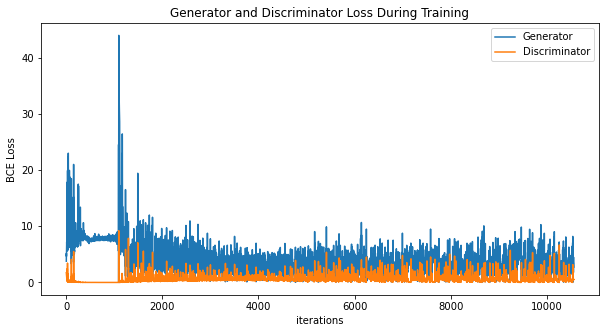

In [13]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="Generator")
plt.plot(D_losses,label="Discriminator")
plt.xlabel("iterations")
plt.ylabel("BCE Loss")
plt.legend()
plt.show()

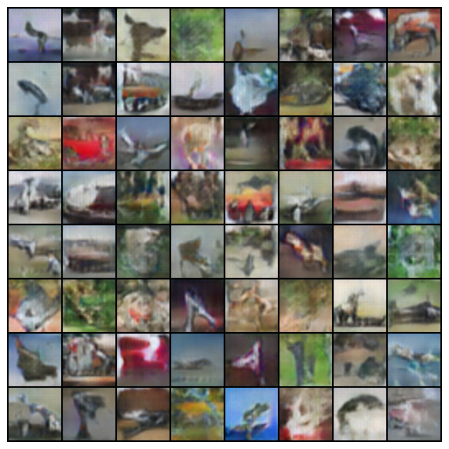

In [14]:
import matplotlib.animation as animation
from IPython.display import HTML

fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

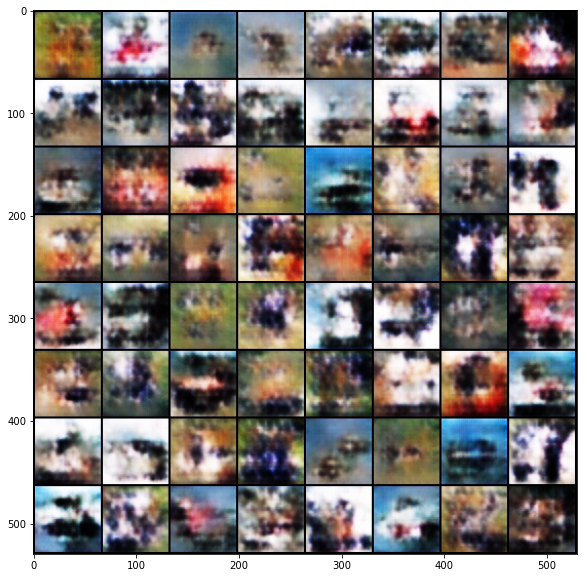

In [24]:
noise = torch.randn(64,opt.nz,1,1).cuda()
noise = torch.autograd.Variable(noise)
fake_u = generator(noise)
imgs = torchvision.utils.make_grid(fake_u.data*0.5+0.5).cpu()
plt.figure(figsize=(10,10))
plt.imshow(imgs.permute(1,2,0).numpy())
plt.show()